In [1]:
import io
from PIL import Image
import torch
from torchvision import transforms
import matplotlib.pyplot as plt
from kafka import KafkaConsumer

/opt/conda/envs/bigdata/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
model_path = '/home/jovyan/UCF_Crime.pth'

In [3]:
# Kafka consumer setup
consumer = KafkaConsumer(
    'frame_topic',
    bootstrap_servers='localhost:9092',
    auto_offset_reset='earliest'
)

In [4]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from PIL import Image
import torchvision.models as models
import torch.nn.functional as F  # Add this line

# Define your neural network architecture
class FeatureExtractor(nn.Module):
    def __init__(self):
        super(FeatureExtractor, self).__init__()
        # Pre-trained DenseNet121 without the final fully connected layers
        self.densenet = models.densenet121(pretrained=True)
        self.densenet = nn.Sequential(*list(self.densenet.children())[:-1])  # Remove last layer

    def forward(self, x):
        # Use the pre-trained DenseNet121 model
        return self.densenet(x)

class Classifier(nn.Module):
    def __init__(self, num_classes):
        super(Classifier, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc1 = nn.Linear(1024, 256)
        self.fc2 = nn.Linear(256, 1024)
        self.fc3 = nn.Linear(1024, 512)
        self.fc4 = nn.Linear(512, num_classes)
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.avg_pool(x)
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = self.fc4(x)
        return x

class FinalModel(nn.Module):
    def __init__(self, num_classes):
        super(FinalModel, self).__init__()
        self.feature_extractor = FeatureExtractor()
        self.classifier = Classifier(num_classes)

    def forward(self, x):
        features = self.feature_extractor(x)
        output = self.classifier(features)
        return output

# Define and compile the model
model = FinalModel(15)

# Load the weights from the .pth file
model_weights_path = '/home/jovyan/UCF_Crime.pth'
model.load_state_dict(torch.load(model_weights_path, map_location=torch.device('cpu')))
model.eval()  # Set the model to evaluation mode

/home/jovyan/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jovyan/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FinalModel(
  (feature_extractor): FeatureExtractor(
    (densenet): Sequential(
      (0): Sequential(
        (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu0): ReLU(inplace=True)
        (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (denseblock1): _DenseBlock(
          (denselayer1): _DenseLayer(
            (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu1): ReLU(inplace=True)
            (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu2): ReLU(inplace=True)
            (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          )
          (denselayer2):

In [5]:
# Define a list to store the predicted class indices
predicted_classes = []

In [6]:
# Define the class labels
CLASS_LABELS = ['Abuse','Arrest','Arson','Assault','Normals','Explosion','Fighting',
                'Burglary', 'Protest', 'RoadAccidents','Robbery','Shooting','Shoplifting',
                'Stealing','Vandalism']

In [7]:
# Define transformation for image preprocessing
transform = transforms.Compose([
transforms.Resize((64, 64)),  # Resize image to fit the input size of the model
        transforms.ToTensor(),  # Convert PIL image to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize image
    ])


Message Received from Kafka Producer


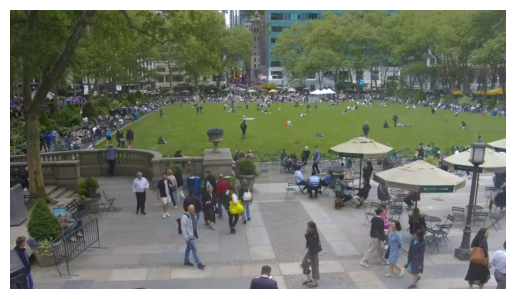

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


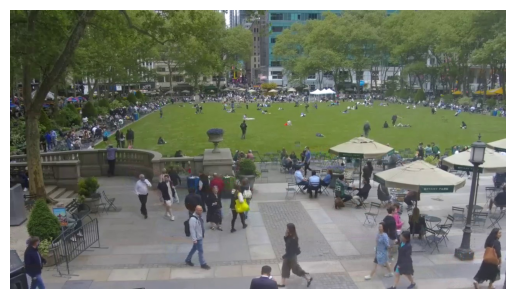

Predicted Class Label: Shoplifting
Predicted Class: 12

Message Received from Kafka Producer


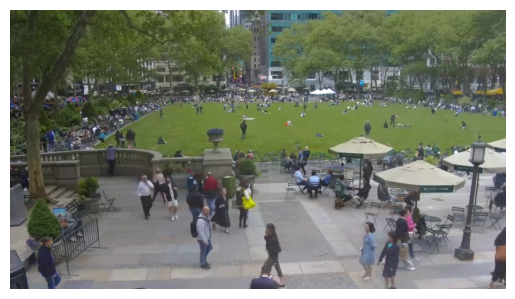

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


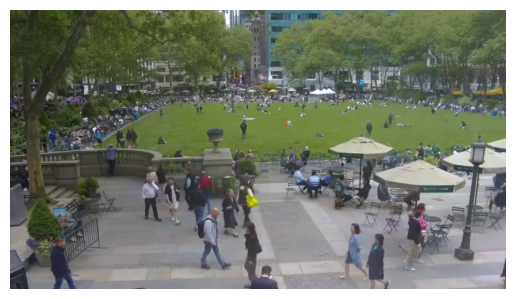

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


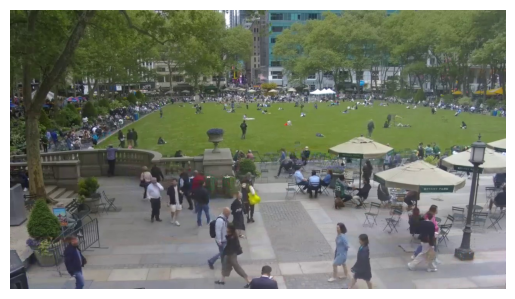

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


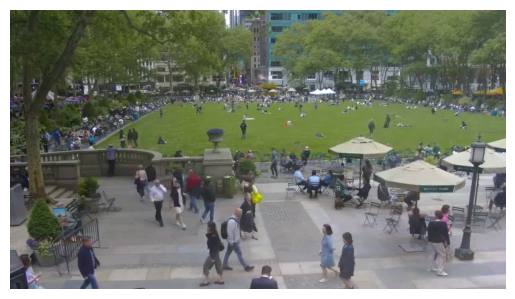

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


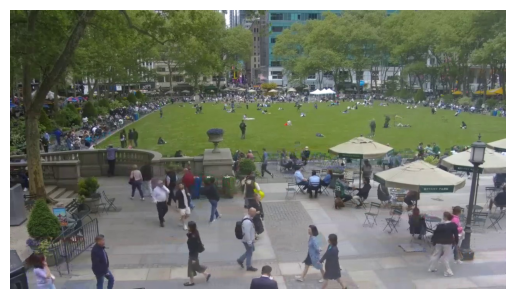

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


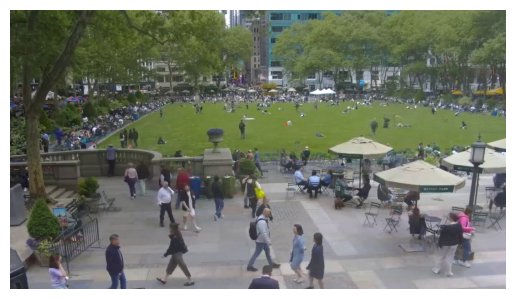

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


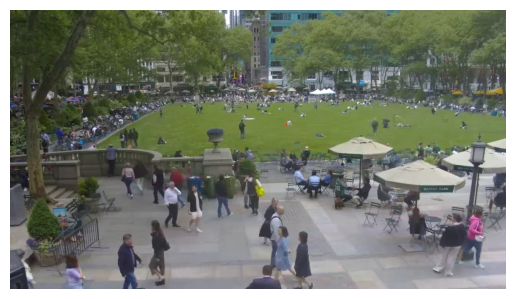

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


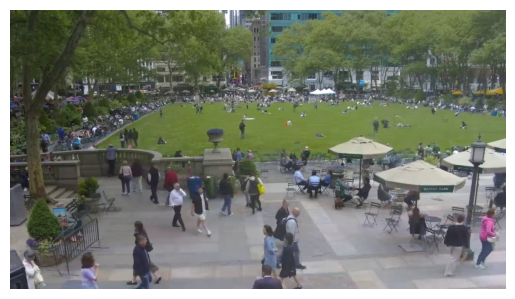

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


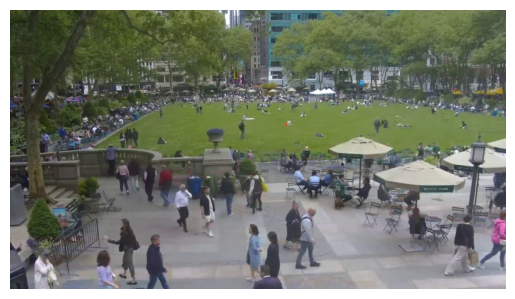

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


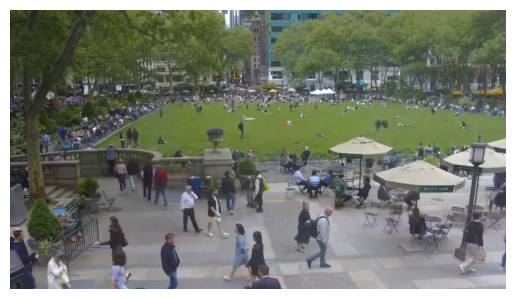

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


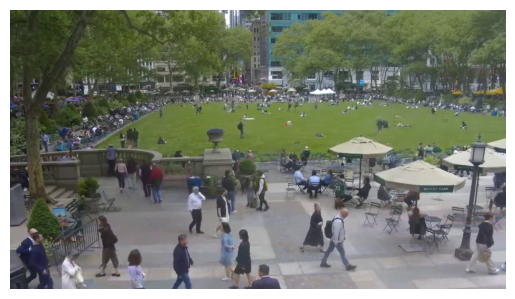

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


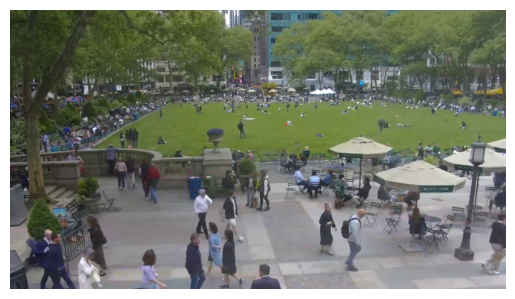

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


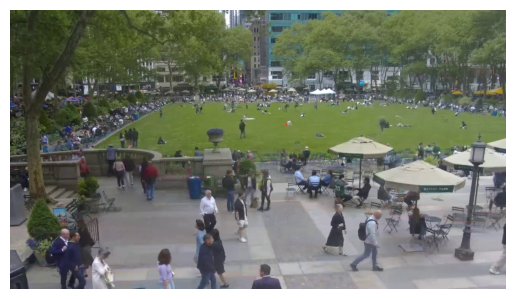

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


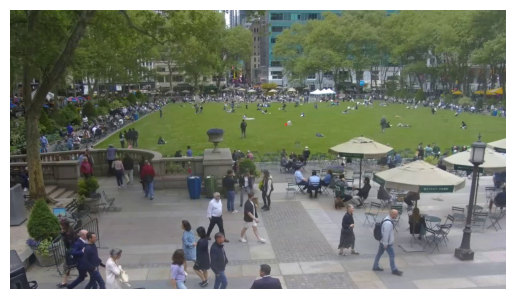

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


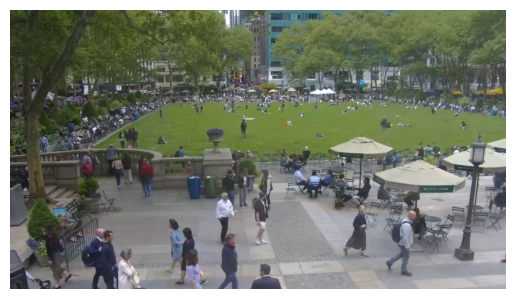

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


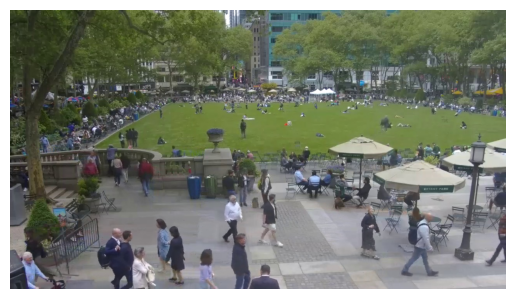

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


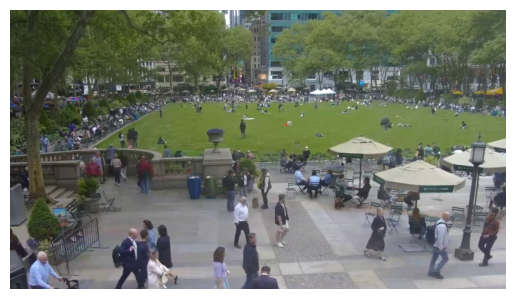

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


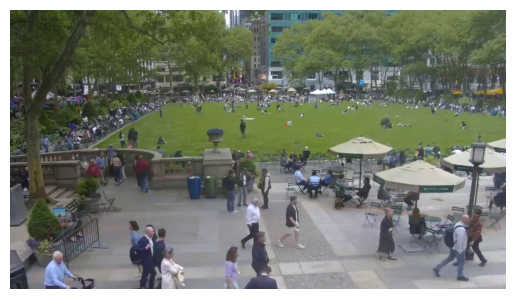

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


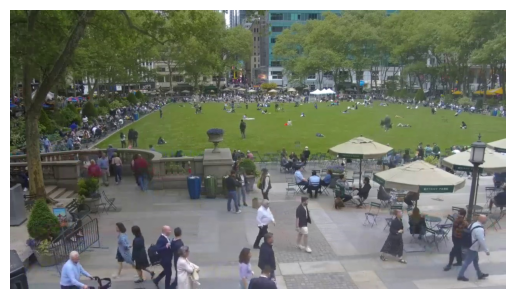

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


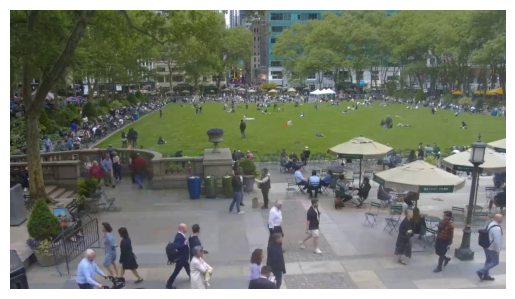

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


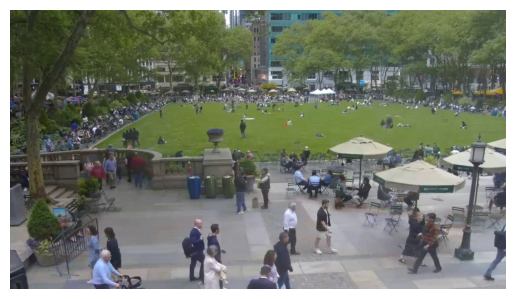

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


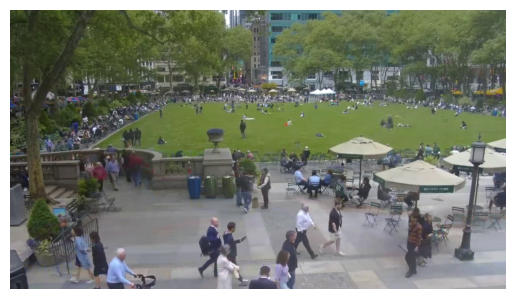

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


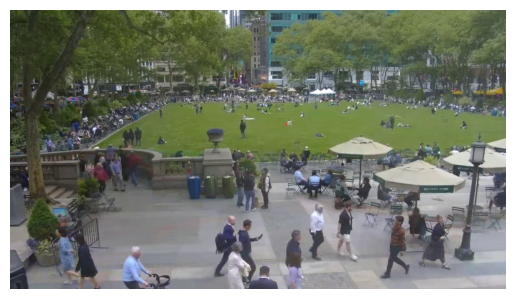

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


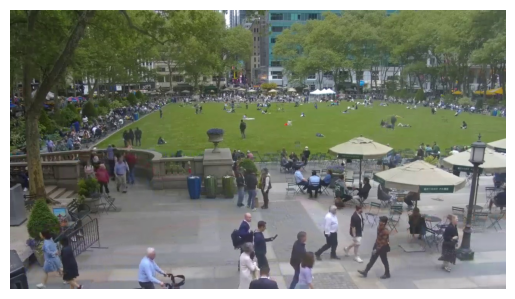

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


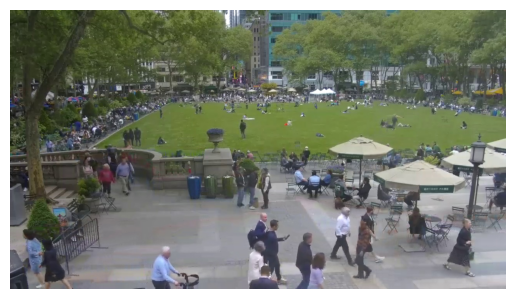

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


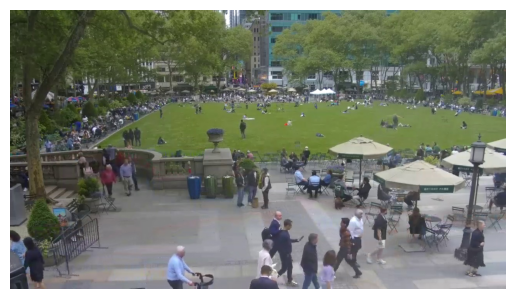

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


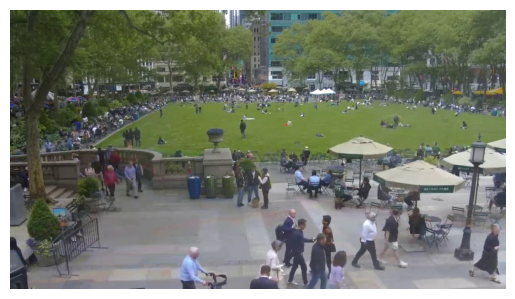

Predicted Class Label: Shoplifting
Predicted Class: 12

Message Received from Kafka Producer


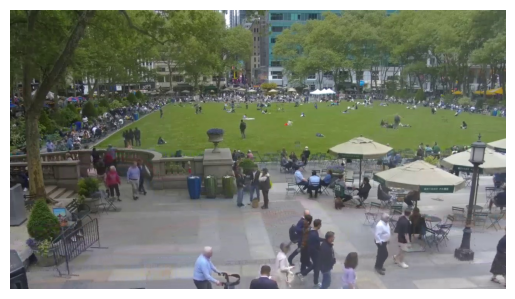

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


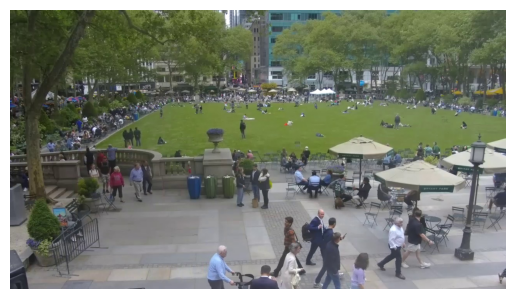

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


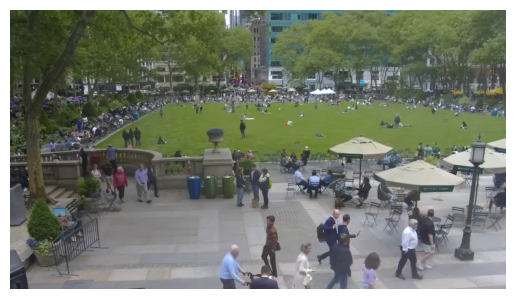

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


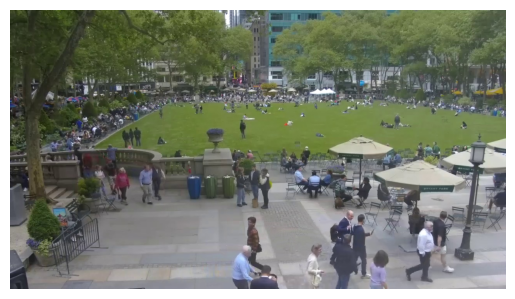

Predicted Class Label: Shoplifting
Predicted Class: 12

Message Received from Kafka Producer


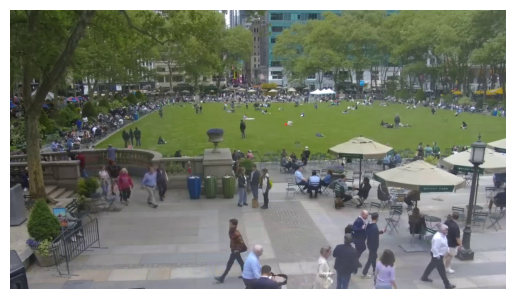

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


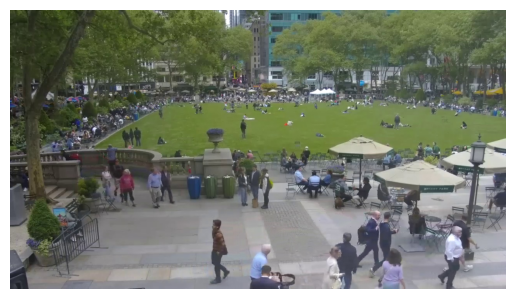

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


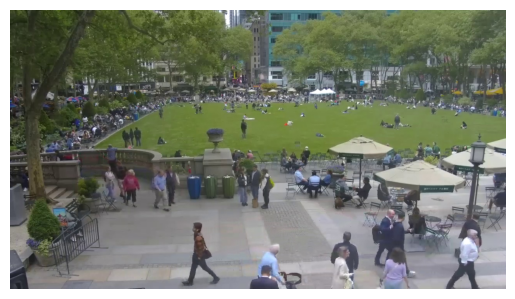

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


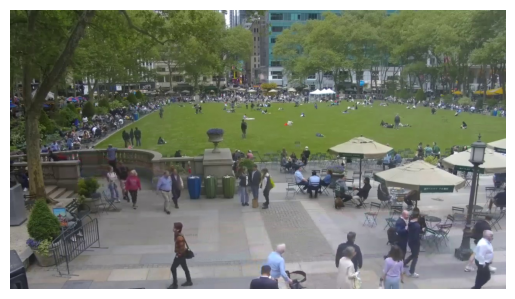

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


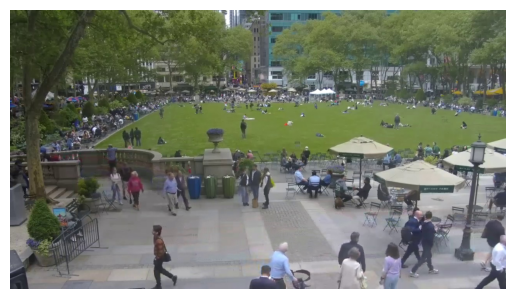

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


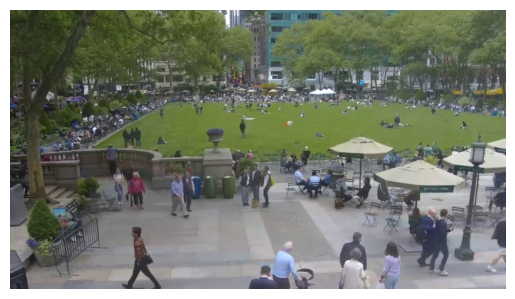

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


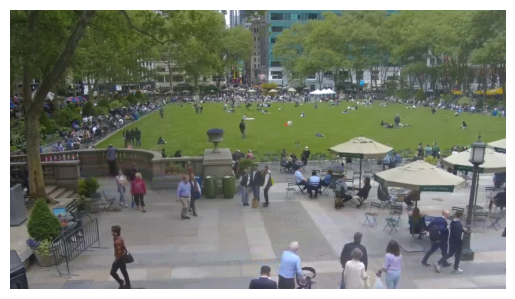

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


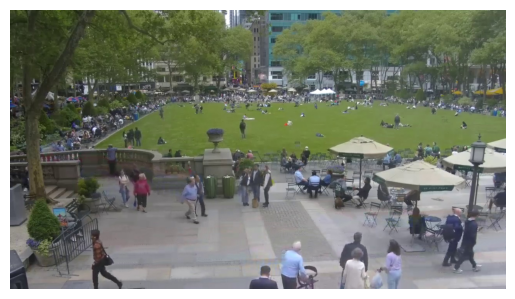

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


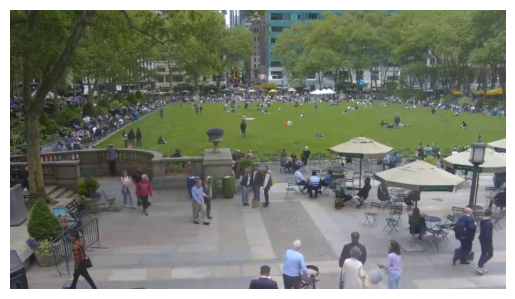

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


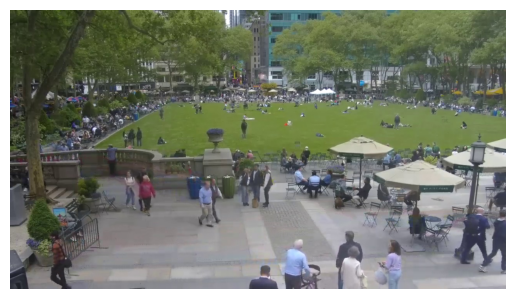

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


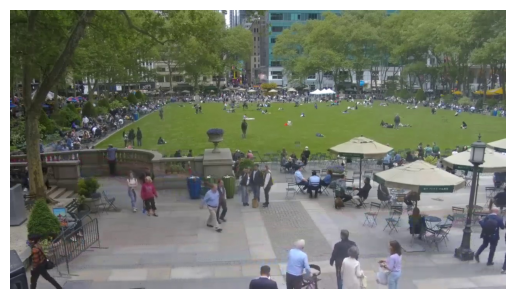

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


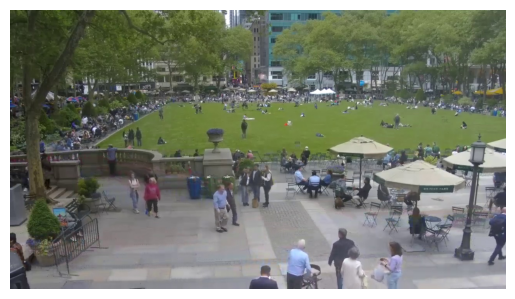

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


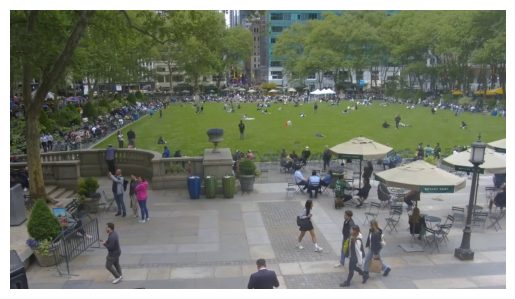

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


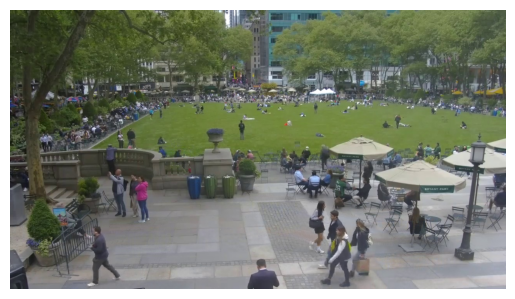

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


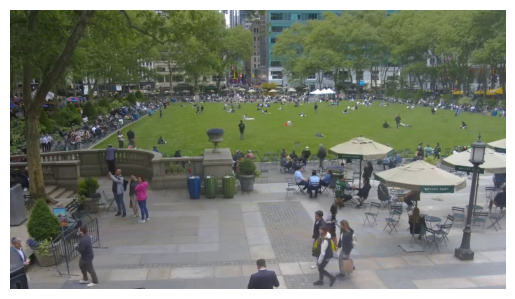

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


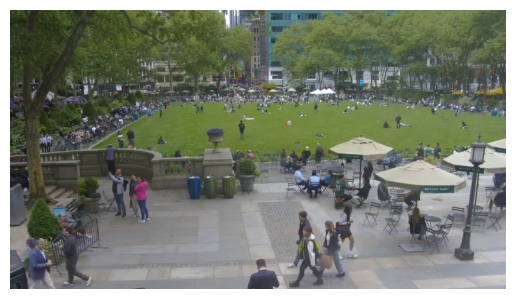

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


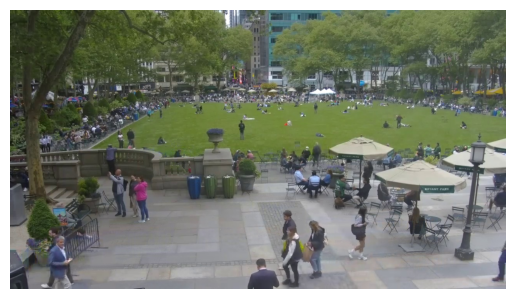

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


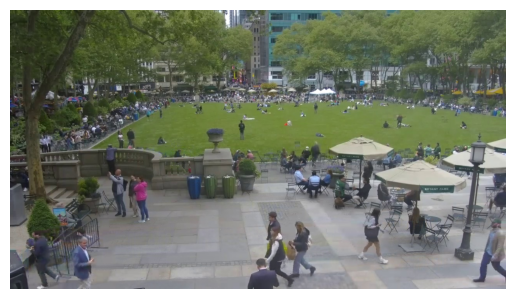

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


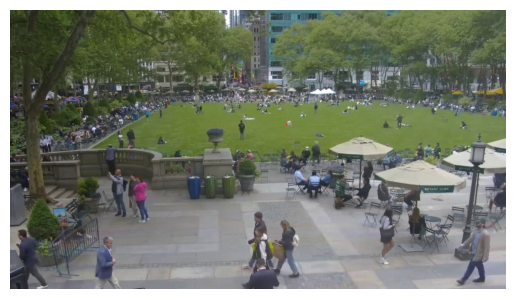

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


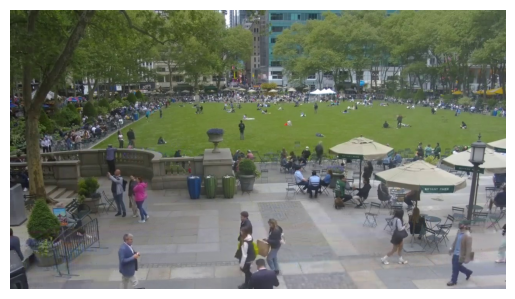

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


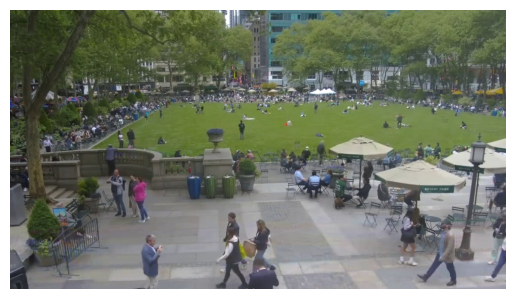

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


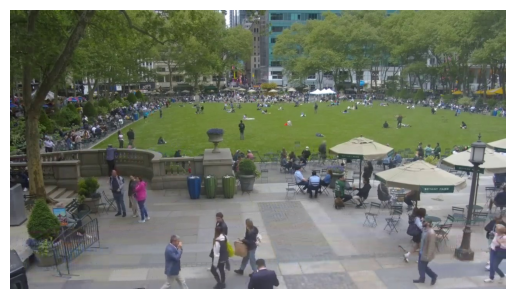

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


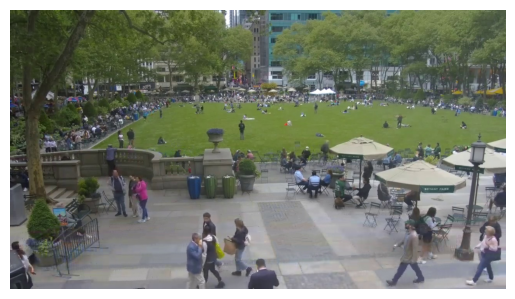

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


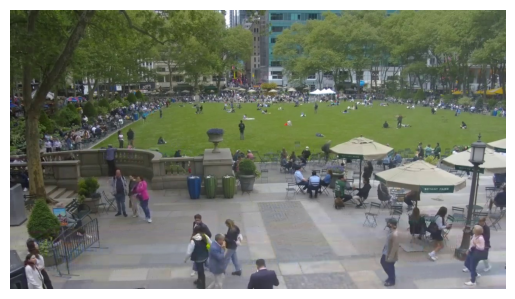

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


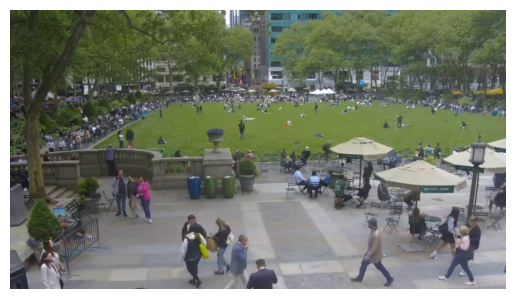

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


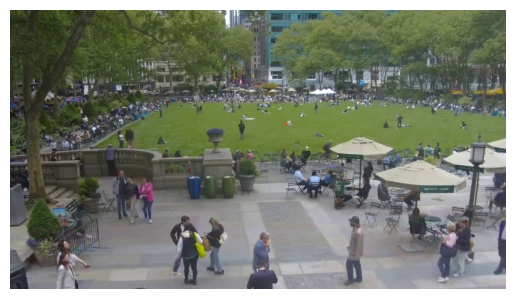

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


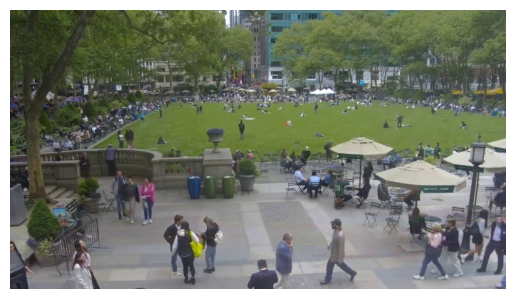

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


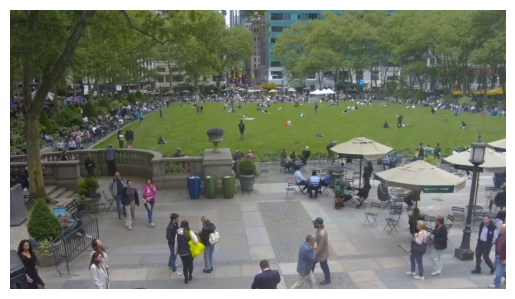

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


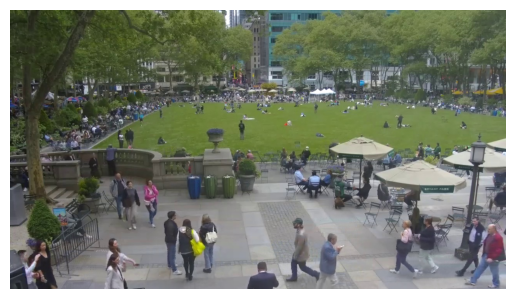

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


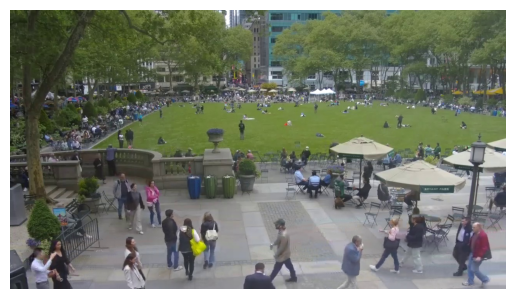

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


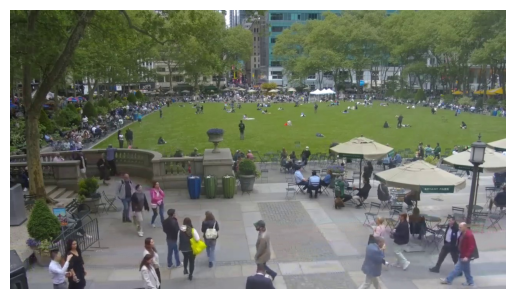

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


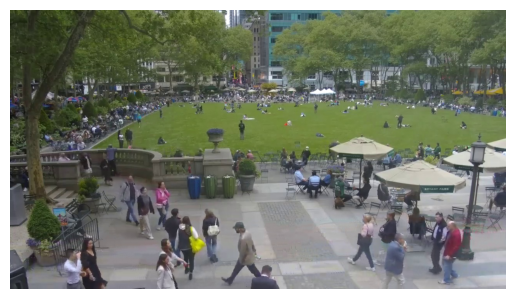

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


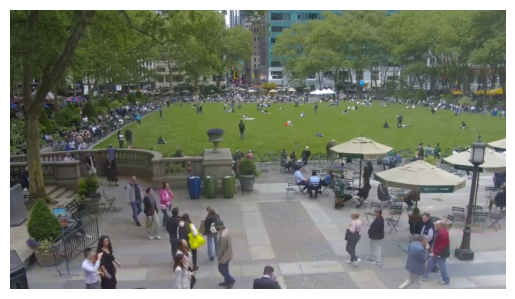

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


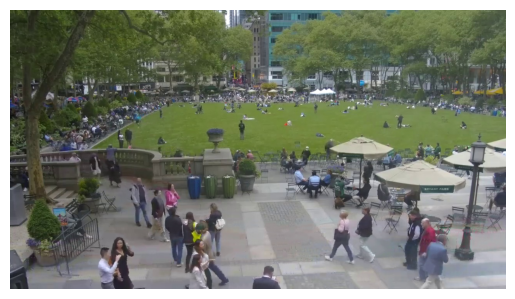

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


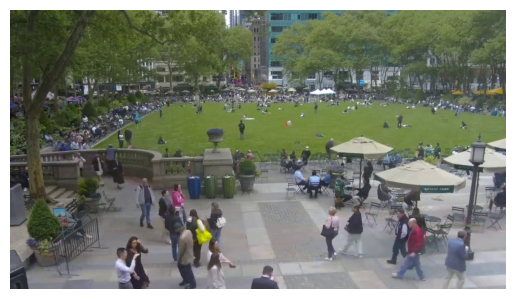

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


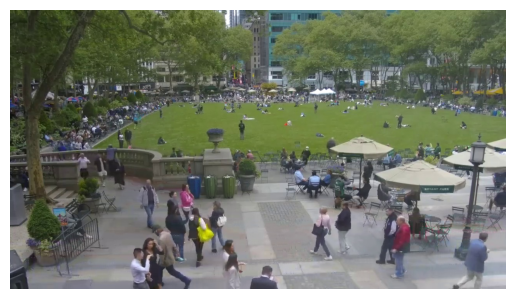

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


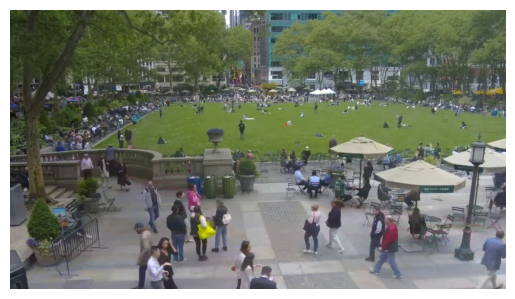

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


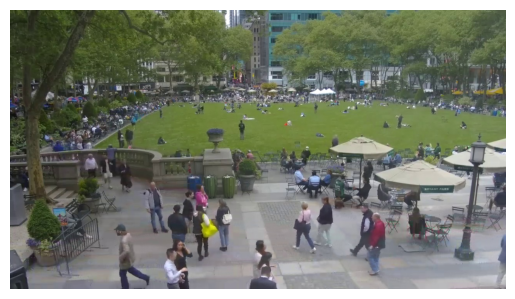

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


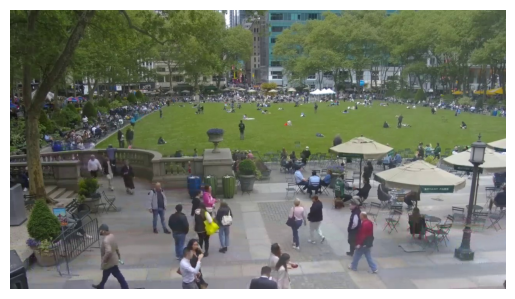

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


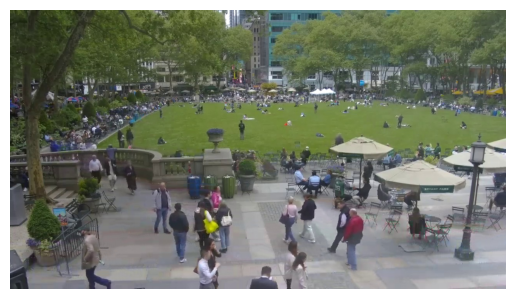

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


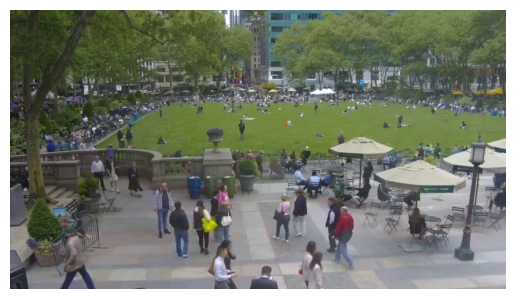

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


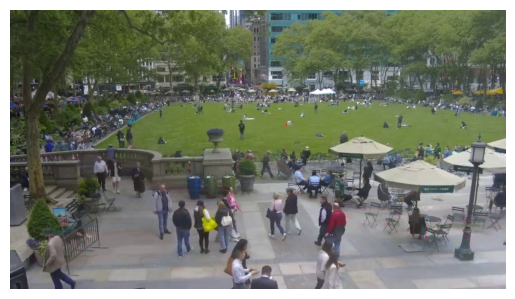

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


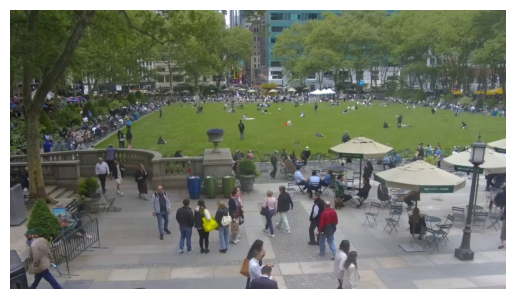

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


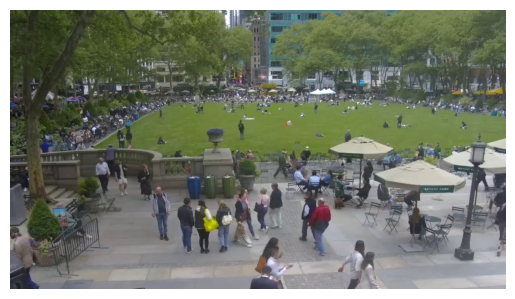

Predicted Class Label: Normals
Predicted Class: 4

Message Received from Kafka Producer


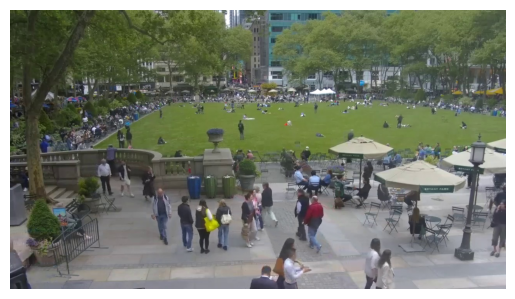

Predicted Class Label: Shoplifting
Predicted Class: 12

Message Received from Kafka Producer


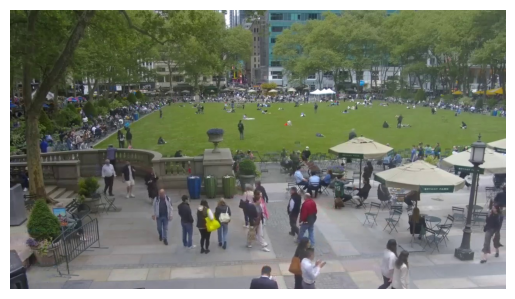

Predicted Class Label: Shoplifting
Predicted Class: 12

Message Received from Kafka Producer


KeyboardInterrupt: 

In [8]:
# Kafka consumer loop
for message in consumer:
    print("\nMessage Received from Kafka Producer")
    try:
        # Preprocess image
        image_stream = io.BytesIO(message.value)
        image = Image.open(image_stream).convert('RGB')
        processed_image = transform(image).unsqueeze(0)  # Add batch dimension
        
        # Convert the processed image tensor to numpy array
        image_np = processed_image.squeeze(0).permute(1, 2, 0).numpy()

        # Display the image
        plt.imshow(image)
        plt.axis('off')
        plt.show()
            
        # Perform inference
        with torch.no_grad():
            output = model(processed_image)
            probabilities = torch.softmax(output, dim=1)
            predicted_class = torch.argmax(probabilities, dim=1).item()

            if CLASS_LABELS:
                print("Predicted Class Label:", CLASS_LABELS[predicted_class])

        # Send prediction back to Kafka or do further processing
        print("Predicted Class:", predicted_class)

    except Exception as e:
        print("Failed to process or display image:", e)